<a href="https://colab.research.google.com/github/San22g119/Analytics/blob/main/Air_Purity.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **1. Introduction and Import Libraries**

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# **2. Loading and Exploring the Dataset**

In [ ]:
df=pd.read_csv('/content/indian_weather_data.csv')

In [ ]:
df.head()

,city,lat,lon,temperature,weather_code,sunrise,sunset,moonrise,moonset,co,...,wind_speed,wind_degree,wind_dir,pressure,precip,humidity,cloudcover,feelslike,uv_index,visibility
0,New Delhi,28.600,77.200,21,143,07:05 AM,05:26 PM,01:04 AM,01:06 PM,1411.85,...,4,34,NE,1017,0.0,53,50,21,0,1
1,Mumbai,18.975,72.826,30,122,07:03 AM,06:03 PM,01:20 AM,01:29 PM,644.85,...,18,300,WNW,1011,0.0,35,0,32,0,4
2,Kolkata,22.570,88.370,21,143,06:07 AM,04:54 PM,12:16 AM,12:23 PM,457.85,...,8,3,N,1014,0.0,73,0,21,0,3
3,Chennai,13.083,80.283,26,143,06:22 AM,05:44 PM,12:48 AM,01:00 PM,275.85,...,19,31,NNE,1012,0.0,65,25,28,0,5
4,Bengaluru,12.983,77.583,24,113,06:32 AM,05:55 PM,12:59 AM,01:11 PM,243.85,...,9,76,ENE,1015,0.0,25,0,24,0,10


# **3. Data Structure and Missing Value Analysis**

In [ ]:
df.info()
print("\n" + "-"*40 + "\n")
print(f"Number of Missing Values: {df.isnull().sum().sum()}")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 74 entries, 0 to 73
Data columns (total 25 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   city          74 non-null     object 
 1   lat           74 non-null     float64
 2   lon           74 non-null     float64
 3   temperature   74 non-null     int64  
 4   weather_code  74 non-null     int64  
 5   sunrise       74 non-null     object 
 6   sunset        74 non-null     object 
 7   moonrise      74 non-null     object 
 8   moonset       74 non-null     object 
 9   co            74 non-null     float64
 10  no2           74 non-null     float64
 11  o3            74 non-null     int64  
 12  so2           74 non-null     float64
 13  pm2_5         74 non-null     float64
 14  pm10          74 non-null     float64
 15  wind_speed    74 non-null     int64  
 16  wind_degree   74 non-null     int64  
 17  wind_dir      74 non-null     object 
 18  pressure      74 non-null     in

# **4. Basic Statistical Summary**

In [ ]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
lat,74.0,24.303824,5.329883,6.133,20.9415,23.3085,28.5925,37.20
lon,74.0,76.853392,6.824777,68.968,73.1625,75.8415,77.6580,118.55
temperature,74.0,22.689189,4.948850,-1.000,20.0000,23.0000,26.0000,31.00
weather_code,74.0,125.283784,19.601174,113.000,113.0000,122.0000,137.7500,248.00
co,74.0,526.498649,355.657039,132.850,265.1000,333.8500,775.1000,1591.85
no2,74.0,6.041892,5.530903,0.850,2.1500,4.6000,8.3000,25.55
o3,74.0,169.256757,40.386510,39.000,146.5000,163.5000,198.7500,264.00
so2,74.0,24.587838,15.250463,1.950,13.6750,19.8500,31.1500,76.65
pm2_5,74.0,48.952703,41.487027,5.750,19.2500,26.8000,76.0000,138.25
pm10,74.0,50.395946,42.537311,5.850,20.4000,27.0500,80.2500,141.95


# **5. Air Quality Analysis: PM2.5 Distribution**

/tmp/ipython-input-3064943508.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x="pm2_5", y="city", data=top_10_pm25, palette="Reds_r")


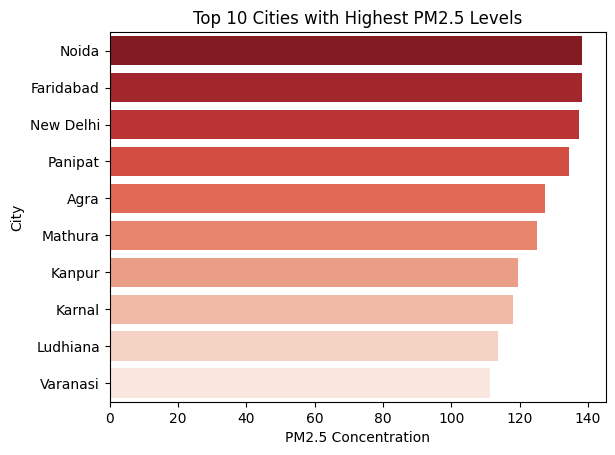

In [ ]:
# Sorting by PM2.5 and taking top 10.
top_10_pm25 = df.nlargest(10, "pm2_5")

# Creating a bar plot.
sns.barplot(x="pm2_5", y="city", data=top_10_pm25, palette="Reds_r")

# Adding chart titles and labels.
plt.title("Top 10 Cities with Highest PM2.5 Levels")
plt.xlabel("PM2.5 Concentration")
plt.ylabel("City")

plt.show() # Show the plot

📊 **Visualization Analysis**

According to PM2.5 concentration rankings, cities in Northern India—particularly Delhi and its surrounding metropolitan areas—are classified within the highest risk category for air pollution. All of these cities consistently exceed the  
100 unit threshold.

# **6. Correlation Heatmap**

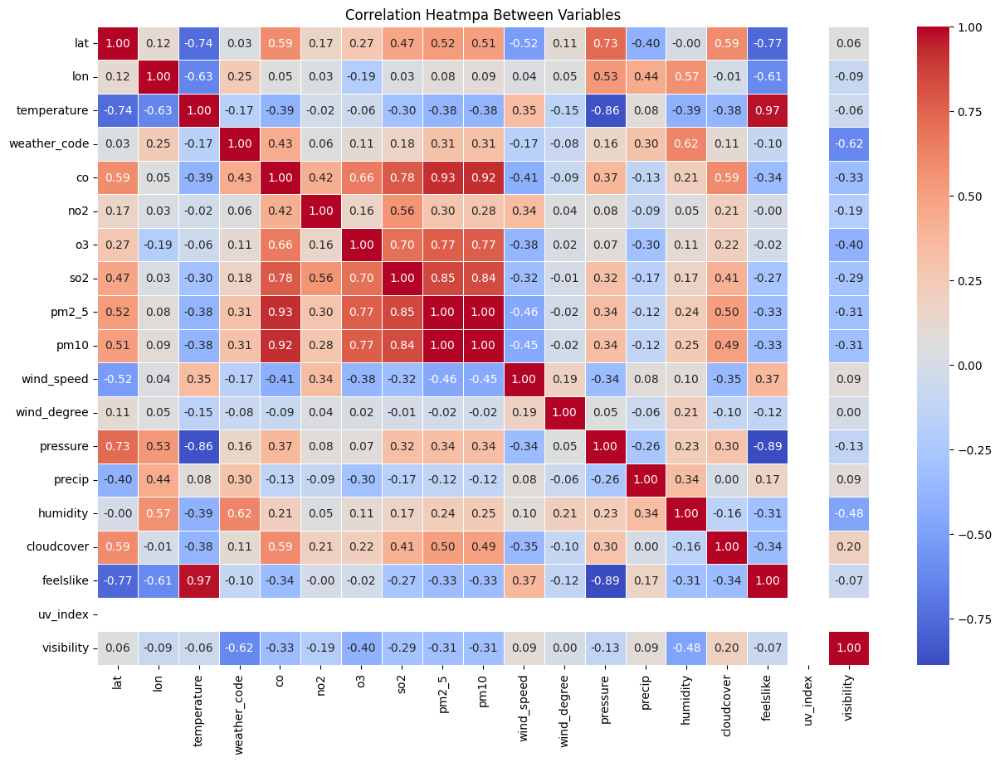

In [ ]:
# Calculating the correlation matrix.
# Selecting only numerical columns.
corr_matrix = df.select_dtypes(include=[np.number]).corr()

# Creating the heatmap
plt.figure(figsize=(15,10)) # Keeping the figure size wide.

# Drawing the heatmap
sns.heatmap(corr_matrix, annot=True, cmap="coolwarm", fmt=".2f", linewidths=0.5)

# Adding title
plt.title("Correlation Heatmpa Between Variables")

plt.show()

# **7. Deep Dive: Pollution vs Temperature**

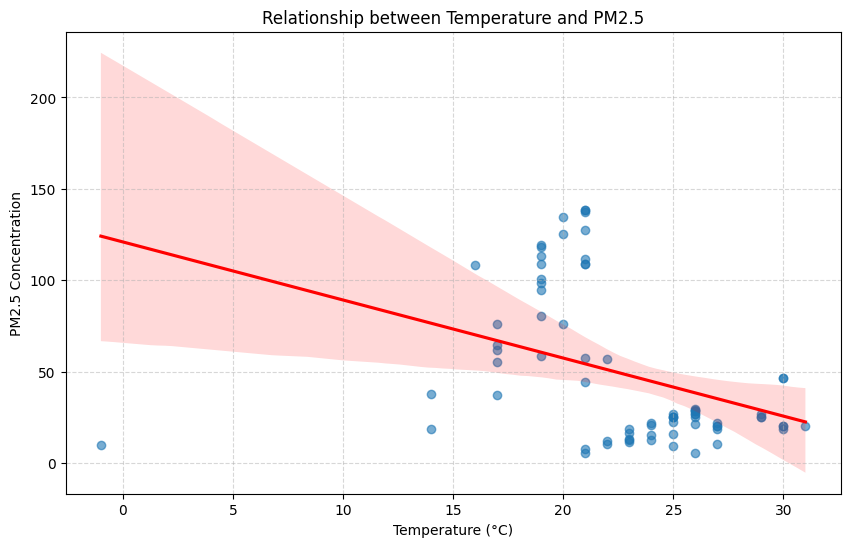

In [ ]:
# Examining the relationship between Temperature and PM2.5
plt.figure(figsize=(10, 6))

# Drawing a scatter plot with a regression line.
sns.regplot(x='temperature', y='pm2_5', data=df, scatter_kws={'alpha':0.6}, line_kws={'color':'red'})

# Adding chart titles and labels.
plt.title("Relationship between Temperature and PM2.5")
plt.xlabel("Temperature (°C)")
plt.ylabel("PM2.5 Concentration")

plt.grid(True, linestyle="--", alpha=0.5) # Adding grid for better readability.
plt.show()

# **8. AQI Categorization**

/tmp/ipython-input-1913553576.py:19: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x="Air_Quality_Status", data=df, palette="viridis",


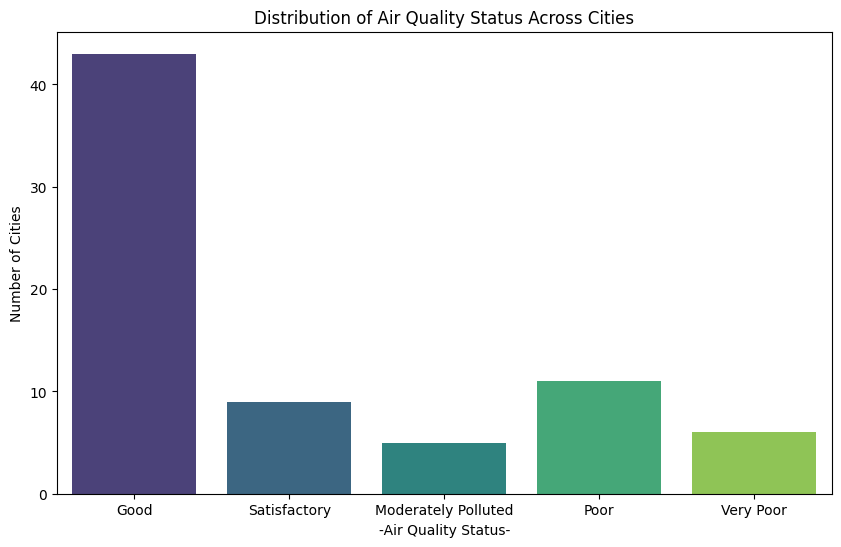

In [ ]:
# Defining a function to categorize air quality.
def categorize_aqi(pm25):
    if pm25 <= 30:
        return "Good"
    elif pm25 <= 60:
        return "Satisfactory"
    elif pm25 <= 90:
        return "Moderately Polluted"
    elif pm25 <= 120:
        return "Poor"
    else:
        return "Very Poor"

# Creating a new column.
df["Air_Quality_Status"] = df["pm2_5"].apply(categorize_aqi)

# Visualizing the distribution of categories.
plt.figure(figsize=(10, 6))
sns.countplot(x="Air_Quality_Status", data=df, palette="viridis",
             order=["Good", "Satisfactory", "Moderately Polluted", "Poor", "Very Poor"])

plt.title("Distribution of Air Quality Status Across Cities")
plt.xlabel("-Air Quality Status-")
plt.ylabel("Number of Cities")
plt.show()

**📊 Air Quality Distribution Analysis**

The vast majority of the 74 cities in our dataset (more than 40) exhibit 'Good' air quality. However, approximately 15-20 cities fall into the 'Poor' or 'Very Poor' categories, posing significant public health risks. These outliers are driven by northern cities such as Noida and Delhi, as previously observed in our visualizations

# **9. Preprocessing: Feature Selection**

In [ ]:
# Selection features for the model.
# We are removing other pollutants like pm10, co, and no2 because they are directly correlated with pm2.5.
features = ['temperature', 'wind_speed', 'wind_degree', 'pressure', 'humidity', 'cloudcover', 'visibility', 'lat', 'lon']
X = df[features] # Independent variables
y = df["pm2_5"] # Target variable

# Splitting the data into Training and Test sets.
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Checking the shapes of train and test sets.
print(f"Train Set Shape: {X_train.shape}")
print(f"Test Set Shape: {X_test.shape}")

Train Set Shape: (59, 9)
Test Set Shape: (15, 9)


# **10. Model Building and Training**

In [ ]:
# Importing Random Forest Regressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, r2_score

# Defining and training the model.
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

# Making predictions on the test set.
y_pred = rf_model.predict(X_test)

# Evaluating model performance.
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Mean Absolute Error - MAE: {mae:.2f}")
print(f"R2 Score: {r2:.2f}")

Mean Absolute Error - MAE: 13.59
R2 Score: 0.76


# **11. Feature Importance**

/tmp/ipython-input-3770460382.py:8: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




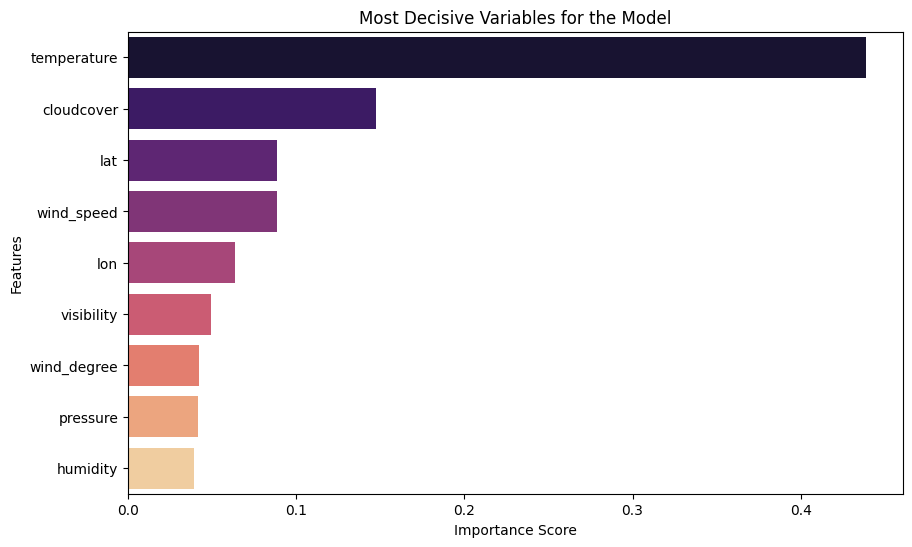

In [ ]:
# Getting feature importance levels.
importances = rf_model.feature_importances_
feature_importance_df = pd.DataFrame({'Feature': features, 'Importance': importances})
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

# Visualizing feature importance.
plt.figure(figsize=(10,6))
sns.barplot(x="Importance", y="Feature", data=feature_importance_df, palette="magma")

plt.title("Most Decisive Variables for the Model")
plt.xlabel("Importance Score")
plt.ylabel("Features")
plt.show()

# **12. Conclusion and General Evaluation**

In [ ]:
# Printing the summary results of the project
print("--- PROJECT SUMMARY ---")
print(f"Total Citie): {len(df)}")
print(f"Model R2 Score: %{r2*100:.1f}")
print(f"Top Predictor: {feature_importance_df.iloc[0]['Feature']}")

--- PROJECT SUMMARY ---
Total Citie): 74
Model R2 Score: %75.6
Top Predictor: temperature


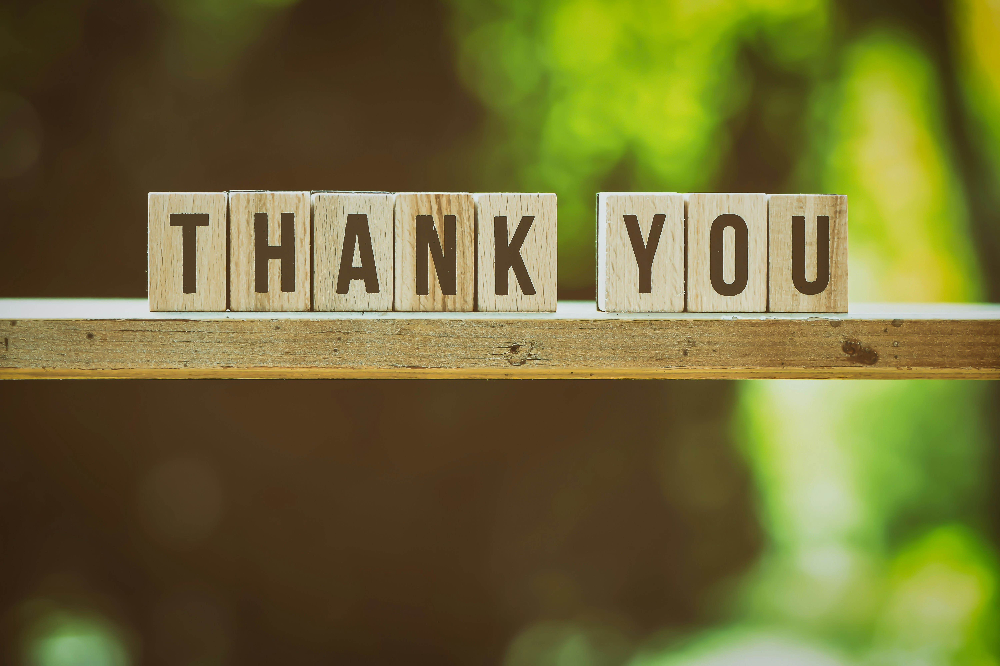

In [ ]:
from PIL import Image
img = Image.open('/content/alexas_fotos-pnGjbJEmU3o-unsplash.jpg')
img